# Real-time Image Smoothing via Iterative Least Squares



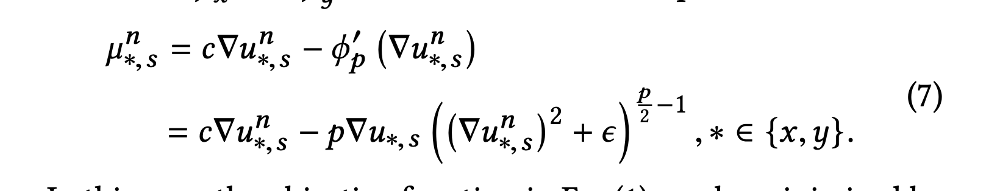

In [1]:
from IPython.display import Image
Image(filename='eq7.png') 

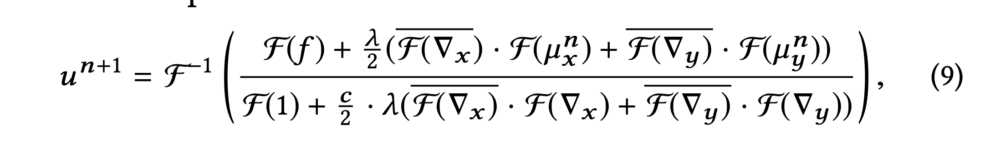

In [2]:
Image(filename='eq9.png') 


## Import needed libraries

In [3]:
from __future__ import division            # forces floating point division 
import numpy as np                          # Numerical Python 
import matplotlib.pyplot as plt             # Python plotting
from PIL import Image                       # Python Imaging Library
import cv2
# to measure exec time
from timeit import default_timer as timer   
import pyfftw

# Show plots in the notebook (don't use it in Python scripts)
%matplotlib inline 


In [4]:
# point spread function (PSF) is impulse response, describes the response of an imaging system to a point source or point object.
# optical transfer function (OTF) is defined as the Fourier transform of the point spread function 
# ---------------------------------------------------------------------

def _fft(img, interface='single'):
    if interface == 'single':
        out = np.fft.fft2(img,axes=(0,1))
    elif interface == 'parallel_numpy':
        out = pyfftw.interfaces.numpy_fft.fft2(img,axes=(0,1))
    elif interface == 'parallel_scipy':
        out = pyfftw.interfaces.scipy_fftpack.fft2(img,axes=(0,1)) 
    return out

def _ifft(img, interface='single'):
    if interface == 'single':
        out = np.fft.ifft2(img,axes=(0,1)).real
    elif interface == 'parallel_numpy':
        out = pyfftw.interfaces.numpy_fft.ifft2(img,axes=(0,1)).real
    elif interface == 'parallel_scipy':
        out = pyfftw.interfaces.scipy_fftpack.ifft2(img,axes=(0,1)).real
    return out


def psf2otf_Dx(outSize, interface):
    psf = np.zeros(outSize)
    psf = psf.astype('float32')
    psf[0, 0] = -1 
    psf[0, -1] = 1 
    otf =  _fft(psf, interface)
    return otf

def psf2otf_Dy(outSize, interface):
    psf = np.zeros(outSize)
    psf = psf.astype('float32')
    psf[0, 0] = -1 
    psf[-1, 0] = 1 
    otf =  _fft(psf, interface)
    return otf

def ILS_Norm(F,c,lam, interface='single'):
    N, M, D = F.shape # (768, 1024, 3)
    sizeI2D = [N, M]

    # ----------------------------------------------------------------------------------------------------------

    # pre-compute
    otfFx = psf2otf_Dx(sizeI2D,interface)
    otfFy = psf2otf_Dy(sizeI2D,interface)

    Denormin = np.abs(otfFx)**2 + np.abs(otfFy)**2  # take the real part and to power of two
    Denormin = Denormin[:,:, np.newaxis] # add a third axis
    Denormin = np.repeat(Denormin, D, axis=2) # repeat the same data D=3 times on the third axis=2

    denominator = 1 + 0.5 * c * lam * Denormin
    
    # ----------------------------------------------------------------------------------------------------------
    U = F
    normin1 =  _fft(U, interface)
    # ----------------------------------------------------------------------------------------------------------

    for i in range(4):
        ## Step 1:  eq 7 - Intermediate variables \mu update, in x-axis and y-axis direction

        # Gradients delta u on x axis and delta u on y axis

        # image gradient in x direction
        u_extra_col = (U[:,0,:] - U[:,-1,:])[:,np.newaxis,:]
        u_extra_row = (U[0,:,:] - U[-1,:,:])[np.newaxis,:,:]

        u_h = np.hstack((np.diff(U,1,1), u_extra_col))
        u_v = np.vstack((np.diff(U,1,0), u_extra_row))


        mu_h = c * u_h - p * u_h * (u_h * u_h + eps)**gamma
        mu_v = c * u_v - p * u_v * (u_v * u_v + eps)**gamma 


        ### ---------------------------------------------------------------------------- ##
        ## Step 2: eq 9 - Update the smoothed image U

        # The diff causes loss in one columns
        extra_col = (mu_h[:,-1,:] - mu_h[:, 0,:])[:,np.newaxis,:]
        extra_row = (mu_v[-1,:,:] - mu_v[0,:,:])[np.newaxis,:,:]    

        # we calculate the diff - the inverse first order derivative of μxn along x-axis & μyn along y-axis 
        normin2_h = np.hstack((extra_col , - np.diff(mu_h,1,1)))
        normin2_v = np.vstack((extra_row , - np.diff(mu_v,1,0)))
        
        fft_normin_h_v = _fft(normin2_h + normin2_v, interface)

        numerator = normin1 + 0.5 * lam * fft_normin_h_v

        FU = numerator / denominator
        U =  _ifft(FU, interface)

        # U = np.abs(ifft2(FU,axes=(0,1)))
        normin1 = FU
    
    return U


def show_image(original, smoothed, t):
    fig = plt.figure(figsize=(20, 16), dpi=80)

    ax1 = fig.add_subplot(3,3,1)
    ax1.imshow(original)
    ax1.set_title('Original Image')

    ax2 = fig.add_subplot(3,3,2)
    ax2.imshow(smoothed)
    ax2.set_title(t)

    smoothed= np.int32(smoothed)
    original= np.int32(original)
    reduced_noise = original - smoothed
    
    ax3 = fig.add_subplot(3,3,3)
    ax3.imshow(reduced_noise)
    ax3.set_title('Reduced Noise')

    plt.show()
    

def show_reduced_noise(original, smoothed, t):
    fig = plt.figure(figsize=(20, 16), dpi=80)

    ax3 = fig.add_subplot(3,3,1)

    reduced_noise = get_reduced_noise_image(original, smoothed)
    ax3.imshow(reduced_noise)
    ax3.set_title(t)

    plt.show()

def show_single_image(img,t=''):
    plt.figure()
    plt.imshow(img)
    plt.title(t)

# Read the image and normalize its values between zero and one
def read_image(image_fulll_path):
    image = Image.open(image_fulll_path) # read the image using PIL
    im = np.asarray(image) # convert the image into numpy array
    info = np.iinfo(im.dtype) # get the data type of the input image
    F = im.astype('float32') / info.max # divide all values by the largest possible value in the datatype
    return F


def get_reduced_noise_image(original, smoothed):
    smoothed= np.int32(smoothed)
    original= np.int32(original)

    return original - smoothed

In [5]:
## # Constants
lam = 1
k = 5
p = 0.8 # Power norm: The parameter p controls the sensitivity to the edges in the input image
eps = 0.0001
gamma = 0.5 * p - 1
c =  p * eps**gamma
# ----------------------------------------------------------------------------------------------------------

F = read_image('test-images/bird2.jpeg')


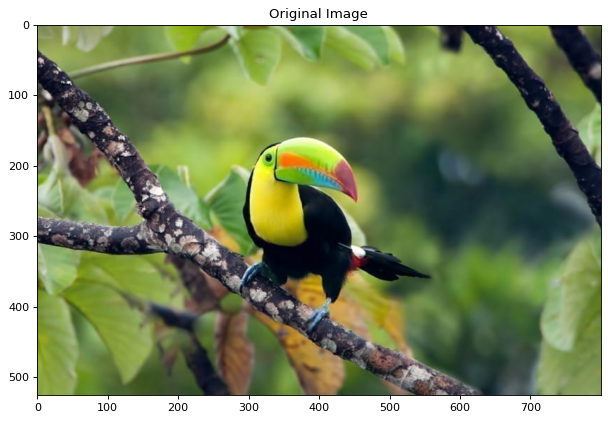

In [6]:
fig = plt.figure(figsize=(20, 16), dpi=80)

ax2 = fig.add_subplot(2,2,1)
ax2.imshow(F)
ax2.set_title('Original Image')

plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


ILS_Norm CPU Single: 1.3961920760000002


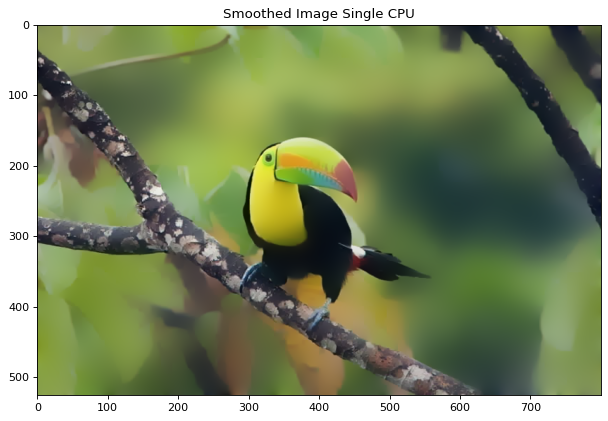

In [7]:


start = timer()
smoothed1 = ILS_Norm(F,c,lam,interface='single')
print("ILS_Norm CPU Single:", timer()-start)    

fig = plt.figure(figsize=(20, 16), dpi=80)

ax2 = fig.add_subplot(2,2,1)
ax2.imshow(smoothed1)
ax2.set_title('Smoothed Image Single CPU')

plt.show()



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


ILS_Norm CPU Parallel Numpy: 0.7848940409999994


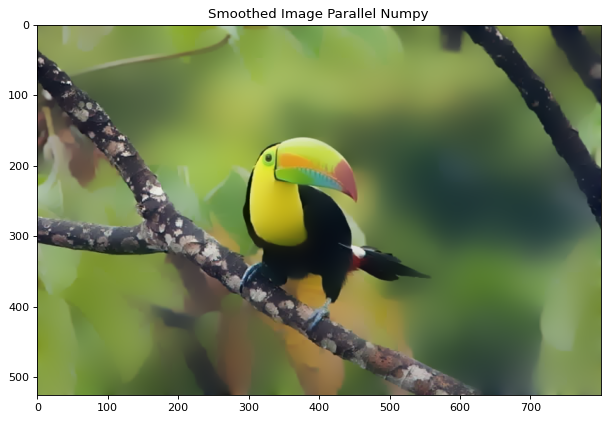

In [8]:

start = timer()
smoothed2 = ILS_Norm(F,c,lam, interface='parallel_numpy')
print("ILS_Norm CPU Parallel Numpy:", timer()-start)    


fig = plt.figure(figsize=(20, 16), dpi=80)

ax2 = fig.add_subplot(2,2,1)
ax2.imshow(smoothed2)
ax2.set_title('Smoothed Image Parallel Numpy')


plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


ILS_Norm CPU Parallel Scipy: 0.7468202759999993


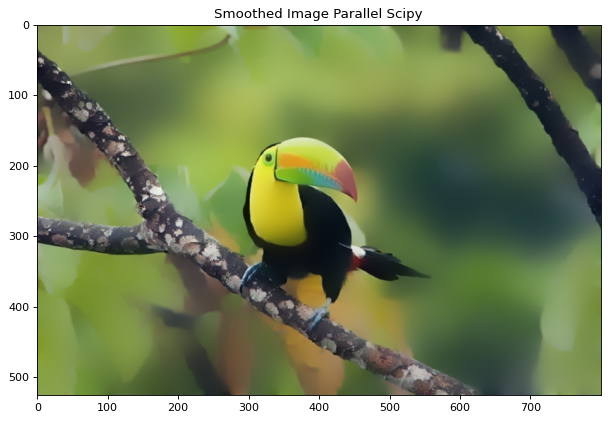

In [9]:


start = timer()
smoothed3 = ILS_Norm(F,c,lam,interface='parallel_scipy')
print("ILS_Norm CPU Parallel Scipy:", timer()-start)    

fig = plt.figure(figsize=(20, 16), dpi=80)

ax2 = fig.add_subplot(2,2,1)
ax2.imshow(smoothed3)
ax2.set_title('Smoothed Image Parallel Scipy')


plt.show()



## Comparsion of different results = All are the same 


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


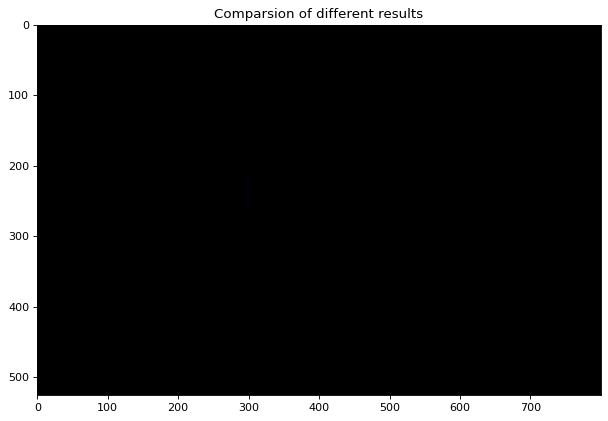

In [10]:
res = smoothed1 - smoothed2 - smoothed3


fig = plt.figure(figsize=(20, 16), dpi=80)

ax2 = fig.add_subplot(2,2,1)
ax2.imshow(res)
ax2.set_title('Comparsion of different results')

plt.show()



In [11]:
print(res.shape)

img = Image.fromarray(res, 'RGB')
print(img.getbbox())

clrs = img.getcolors()
print(clrs)

def is_monochromatic_image(img):
    extr = img.getextrema()
    a = 0
    for i in extr:
        if isinstance(i, tuple):
            a += abs(i[0] - i[1])
        else:
            a = abs(extr[0] - extr[1])
            break
    return a == 0

is_monochromatic_image(img)

(526, 800, 3)
(0, 0, 800, 526)
None


False

# Test on other samples

In [12]:
def ILS(img):
    F = read_image(img)
    smoothed = ILS_Norm(F,c,lam,interface='parallel_scipy')

    fig = plt.figure(figsize=(20, 16), dpi=80)
    ax2 = fig.add_subplot(2,2,1)
    ax2.set_title('Original image')
    ax2.imshow(F)

    ax2 = fig.add_subplot(2,2,2)
    ax2.imshow(smoothed)
    ax2.set_title('ILS - Smoothed image')
    
    plt.show()
    

fish.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


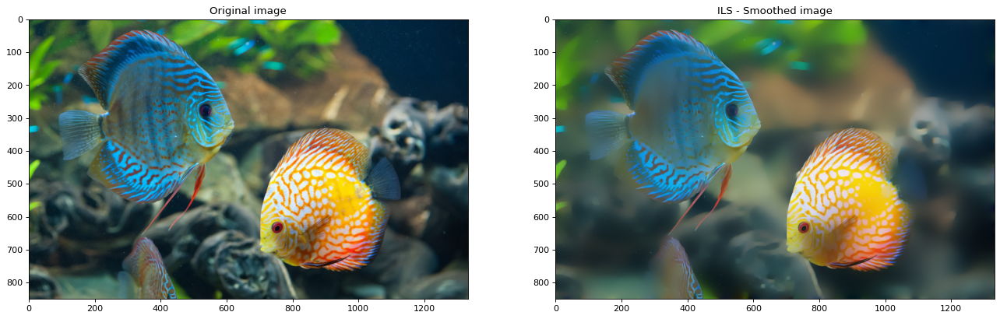

veggies.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


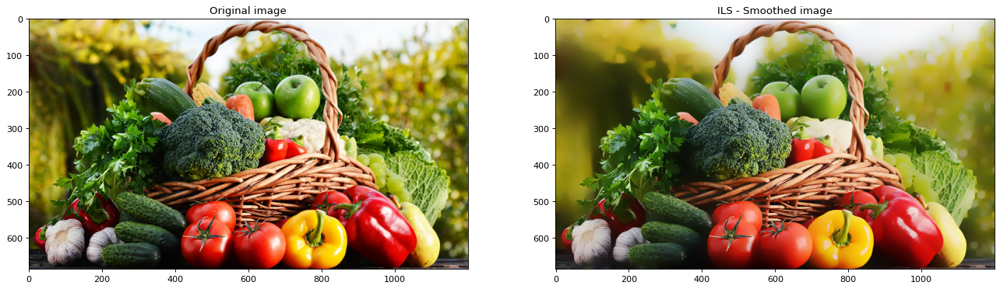

cow.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


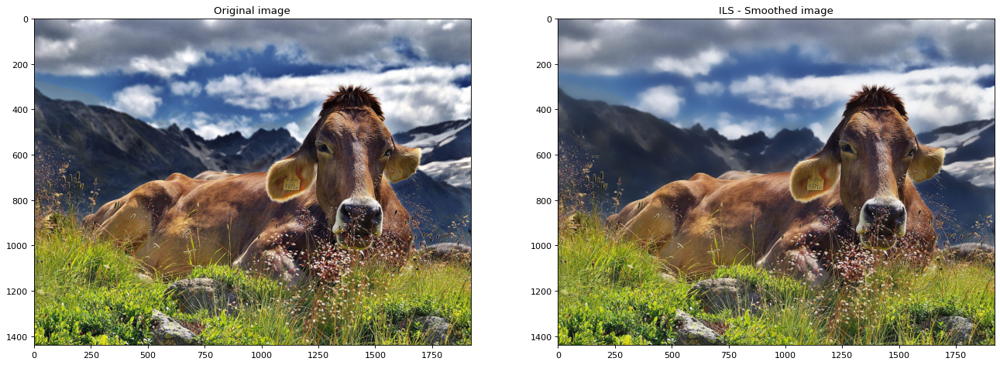

lena.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


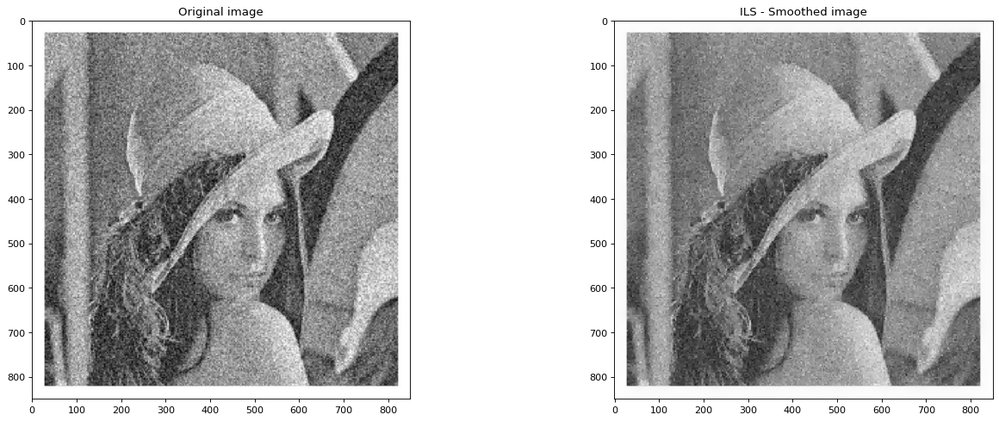

deer.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


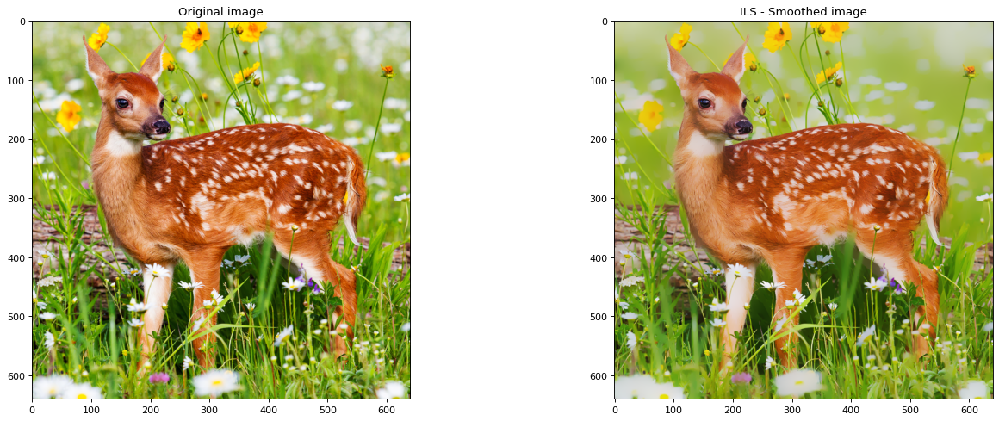

dolphin.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


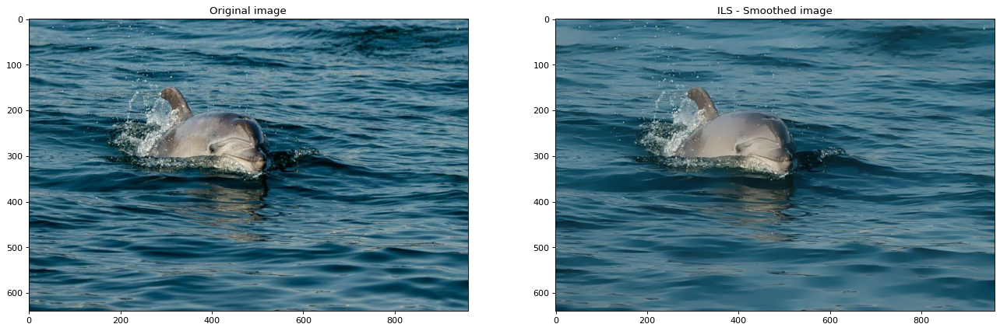

coffe.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


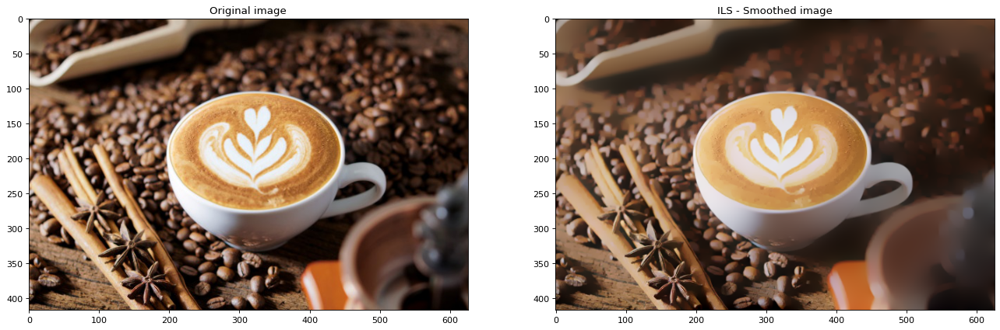

koala.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


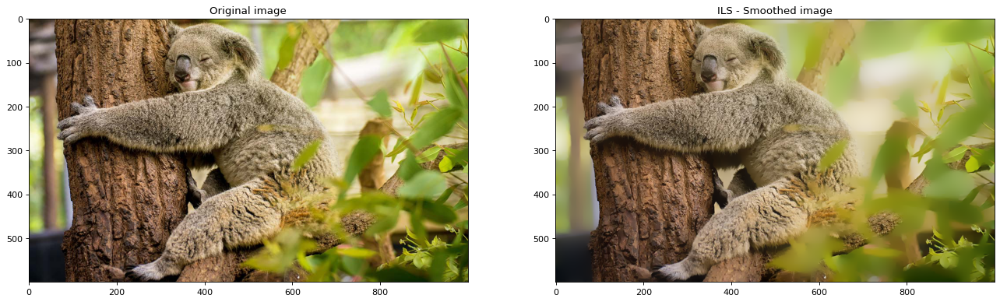

vacc.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


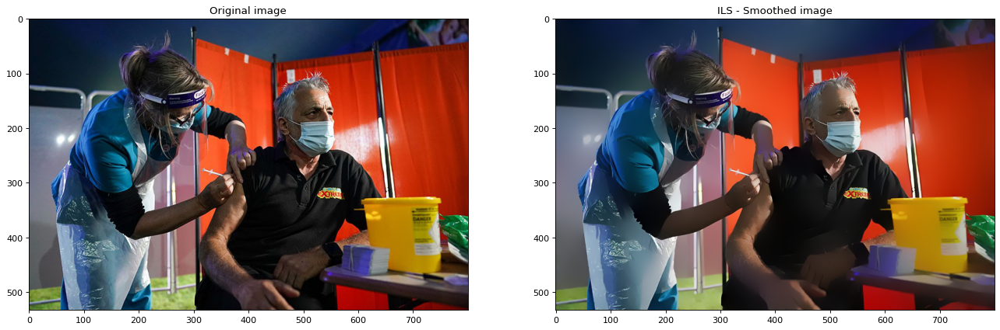

lion.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


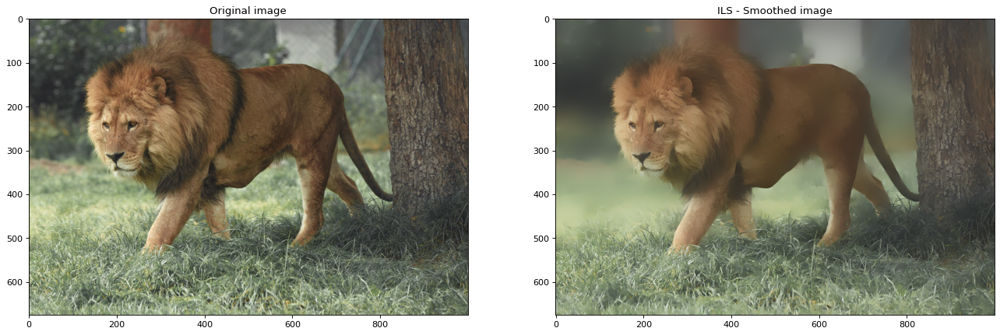

bird.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


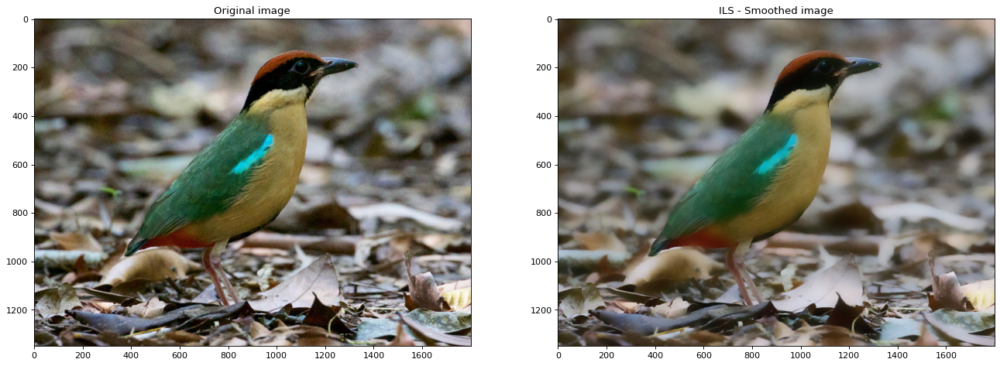

hawk.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


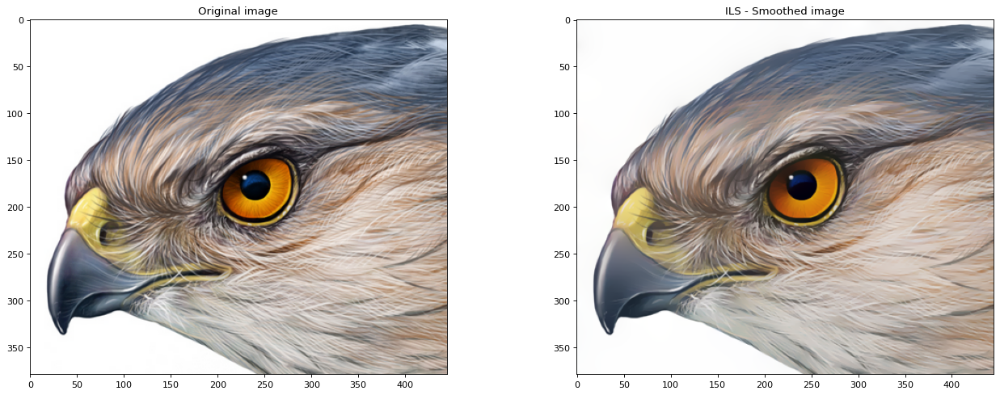

monkeytree.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


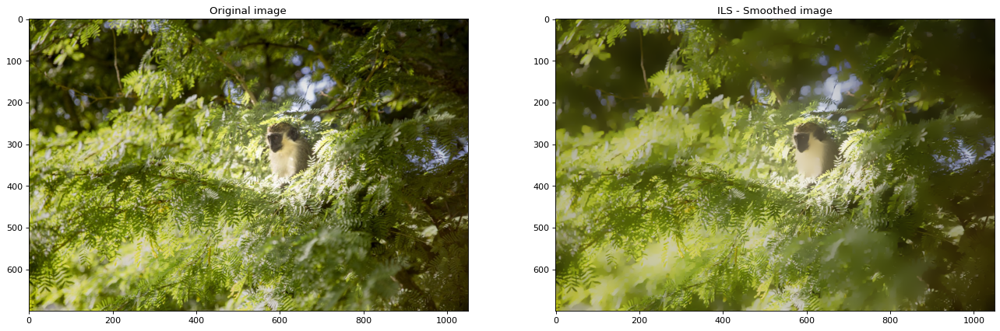

girraffe.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


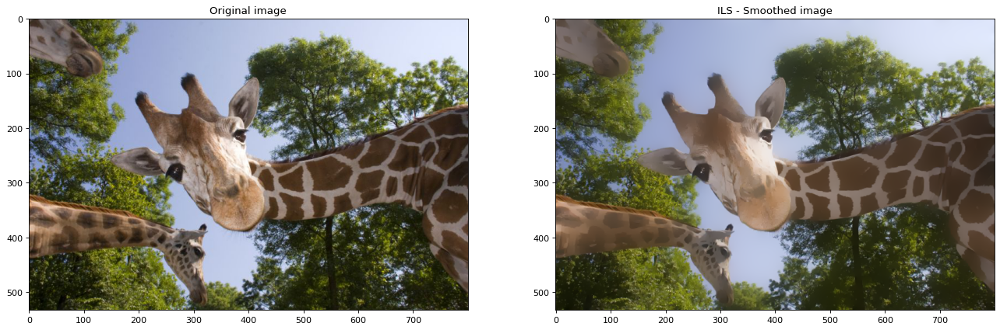

toystory.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


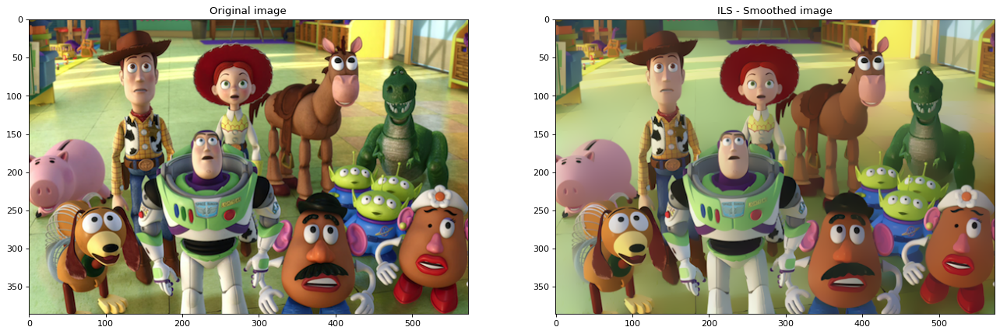

monkey.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


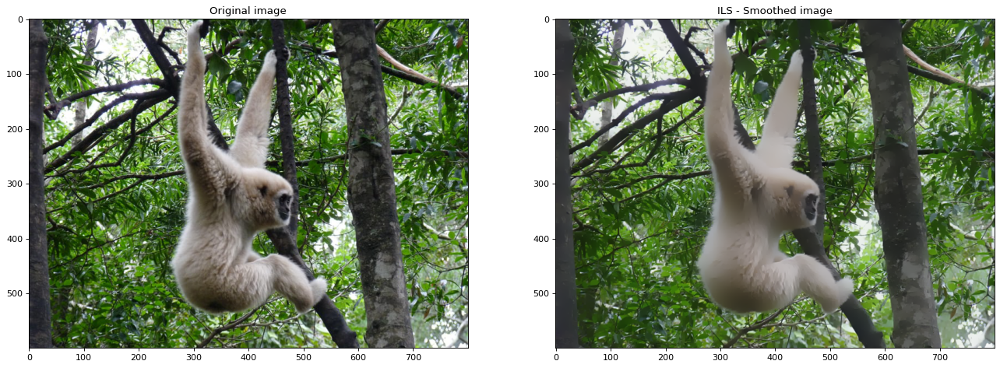

corona.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


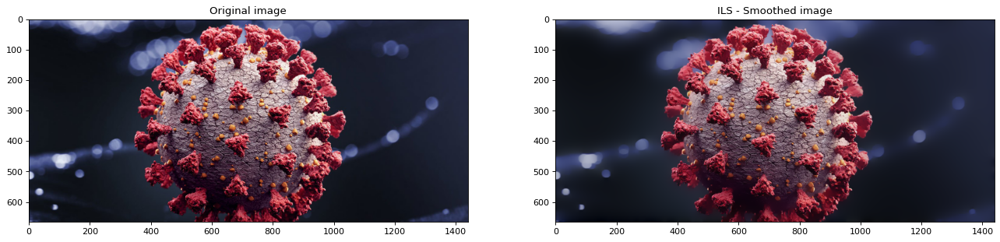

couple.jpg


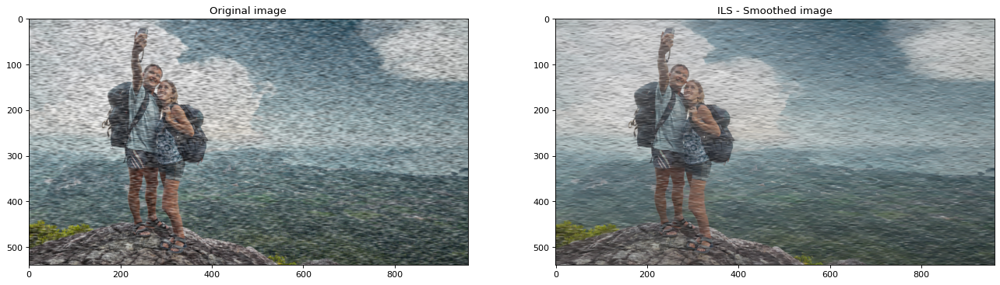

bird2.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


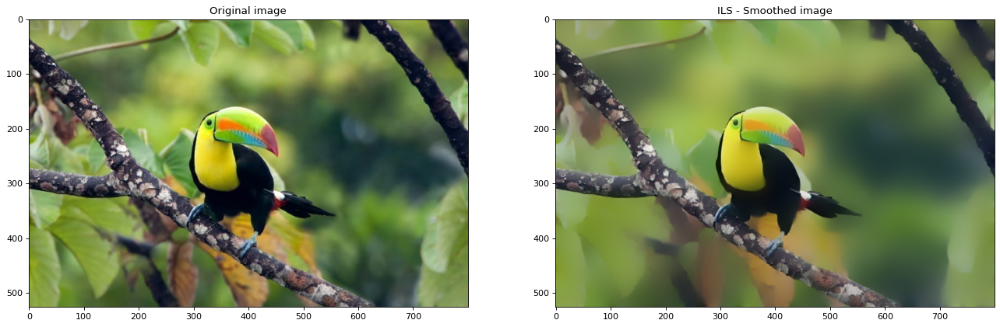

elephant.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


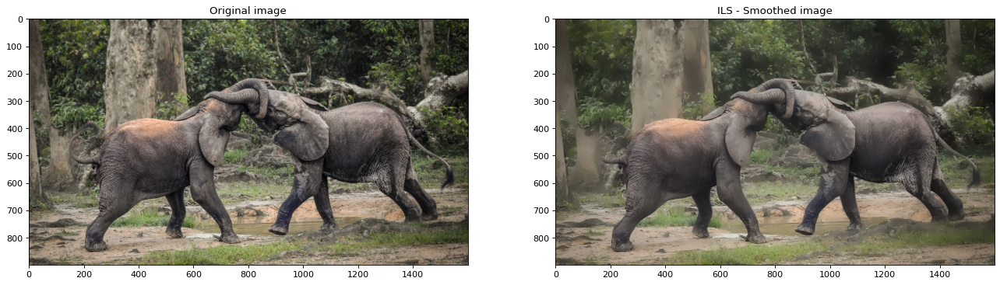

train.jpeg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


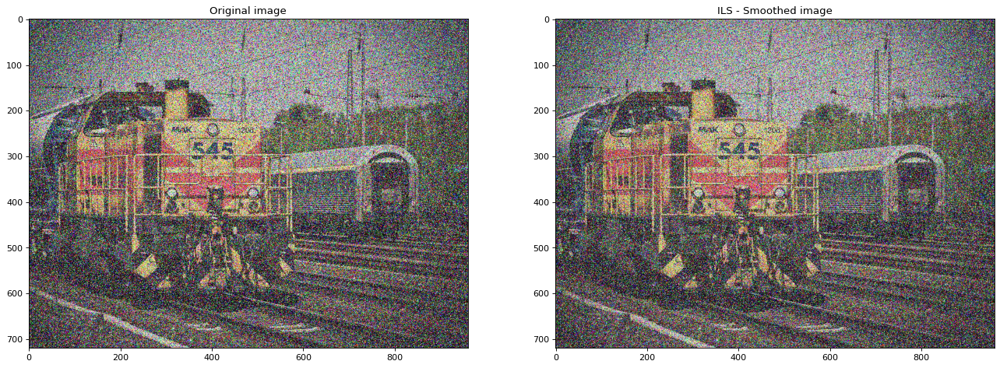

In [13]:
import os
directory = 'test-images/'

for filename in os.listdir(directory):
    if filename.endswith(".png") or filename.endswith(".jpeg") or filename.endswith(".jpg"):
        print(filename)
        ILS(directory + filename)


## Smoothing Images, other methods


https://opencv24-python-tutorials.readthedocs.io/en/stable/py_tutorials/py_imgproc/py_filtering/py_filtering.html

In [14]:
import numpy as np
from matplotlib import pyplot as plt

imgf = np.asarray(Image.open('flower.png'))


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Averaging: 0.008716230999993968


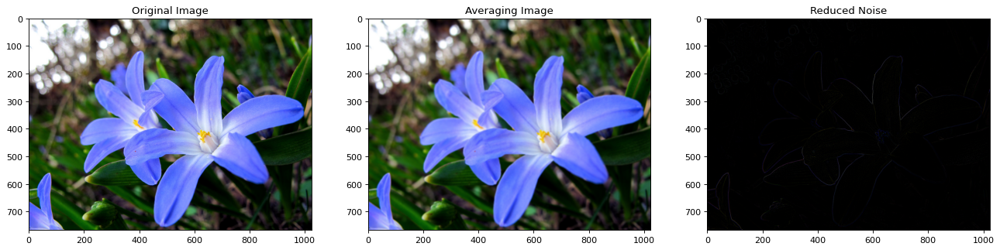

In [15]:

kernel = np.ones((5,5),'float32')/25

start = timer()
dst = cv2.filter2D(imgf,-1, kernel)
print("Averaging:", timer()-start)    


show_image(imgf, dst,t='Averaging Image')


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Blured: 0.0038993050000044605


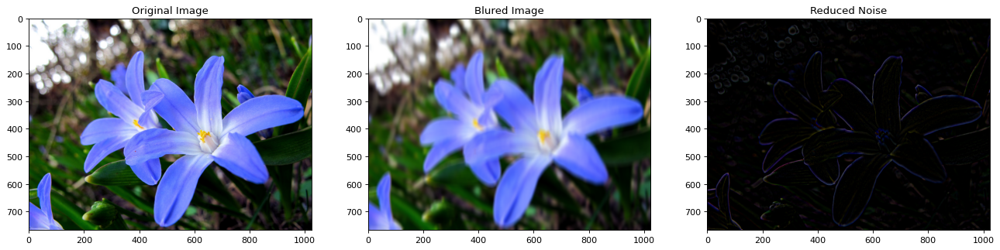

In [16]:


start = timer()
blur      = cv2.blur(imgf,(9,22))
print("Blured:", timer()-start)    

show_image(imgf, blur,t='Blured Image')


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Gaussian Blured: 0.0178456390000008


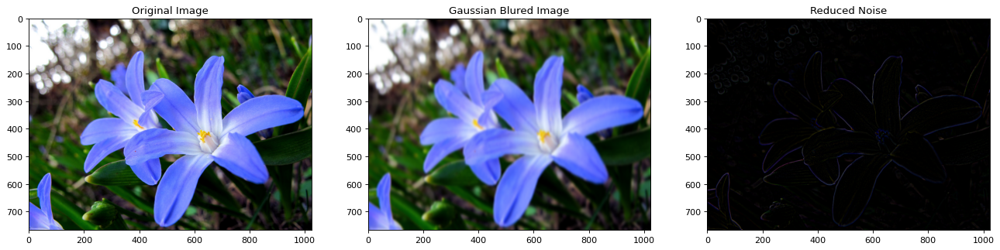

In [17]:


start = timer()
gblur     = cv2.GaussianBlur(imgf,(9,99),cv2.BORDER_DEFAULT)

print("Gaussian Blured:", timer()-start)    

show_image(imgf,gblur,t='Gaussian Blured Image')


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Median: 0.0040842149999917865


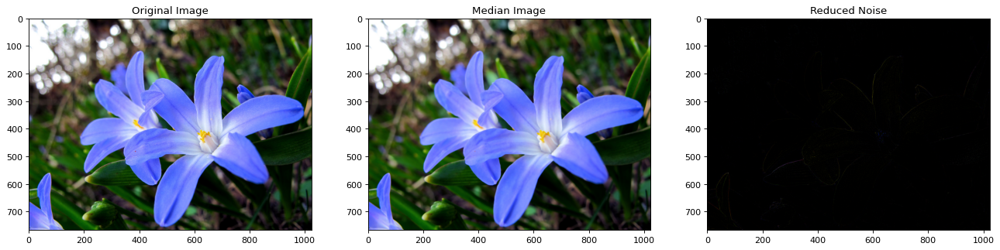

In [18]:

start = timer()
median    = cv2.medianBlur(imgf,5)
print("Median:", timer()-start)    

show_image(imgf,median,t='Median Image')


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Bilateral: 0.0743595149999976


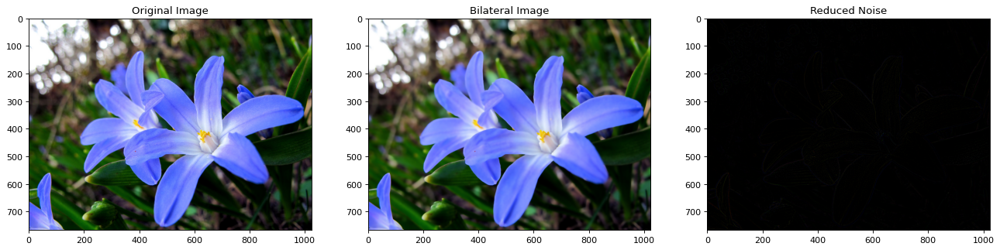

In [19]:

start = timer()
bilateral = cv2.bilateralFilter(imgf,9,75,75)
print("Bilateral:", timer()-start)    

show_image(imgf,bilateral,t='Bilateral Image')



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


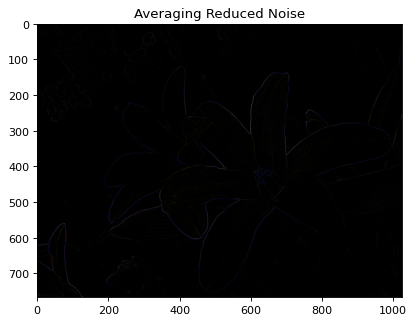

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


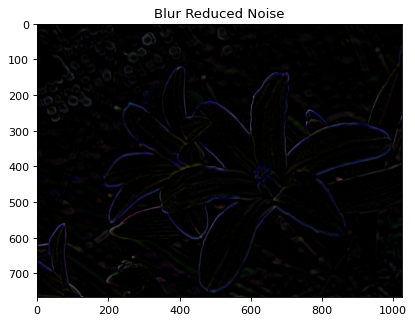

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


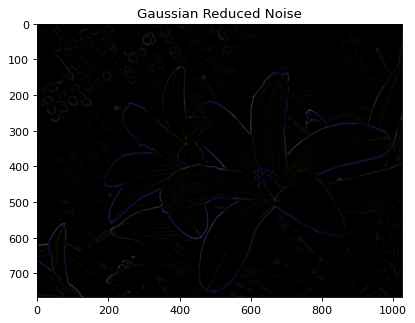

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


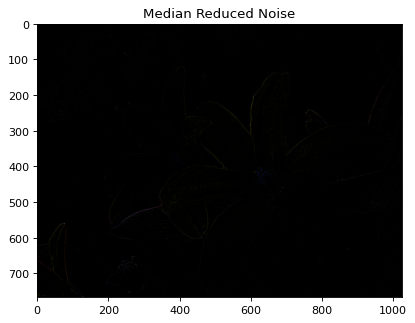

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


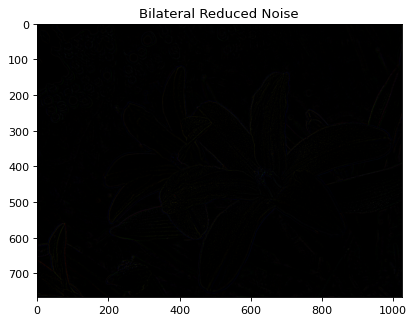

In [20]:

show_reduced_noise(imgf, dst,t='Averaging Reduced Noise')
show_reduced_noise(imgf, blur,t='Blur Reduced Noise')
show_reduced_noise(imgf, gblur,t='Gaussian Reduced Noise')
show_reduced_noise(imgf, median,t='Median Reduced Noise')
show_reduced_noise(imgf, bilateral,t='Bilateral Reduced Noise')


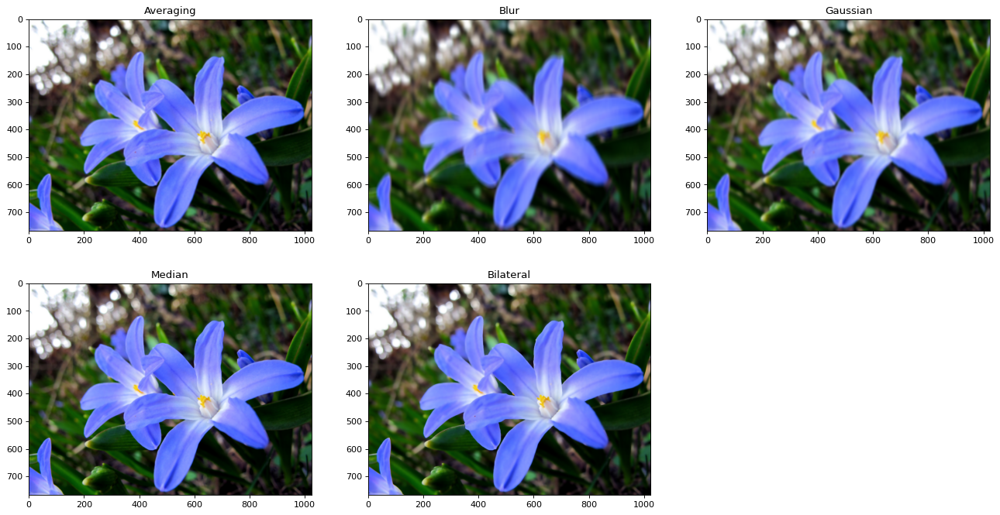

In [21]:

    fig = plt.figure(figsize=(20, 16), dpi=80)

#     ax1 = fig.add_subplot(3,3,1)
#     ax1.imshow(imgf)
#     ax1.set_title('Original Image')

    ax2 = fig.add_subplot(3,3,1)
    ax2.imshow(dst)
    ax2.set_title('Averaging')

    ax2 = fig.add_subplot(3,3,2)
    ax2.imshow(blur)
    ax2.set_title('Blur')

    ax2 = fig.add_subplot(3,3,3)
    ax2.imshow(gblur)
    ax2.set_title('Gaussian')

    ax2 = fig.add_subplot(3,3,4)
    ax2.imshow(median)
    ax2.set_title('Median')

    ax2 = fig.add_subplot(3,3,5)
    ax2.imshow(bilateral)
    ax2.set_title('Bilateral')


    plt.show()